In [1]:
%pip install Pillow
%pip install matplotlib
%pip install nltk

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: pip3.11 install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: pip3.11 install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: pip3.11 install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
def load_doc(filename):
    with open(filename, 'r') as file:
        text = file.read()
    return text

In [3]:
token_filename = "/home/vikrant/RNN/Flickr_8k_Text_unzipped/Flickr_8k_Text/Flickr_8k.token.txt"
train_images_filename = '/home/vikrant/RNN/Flickr_8k_Text_unzipped/Flickr_8k_Text/Flickr_8k.trainImages.txt'
save_description_filename = "/home/vikrant/RNN/Flickr_8k_Text_unzipped/Flickr_8k_Text/token_descriptions.txt"
image_base_dir = "/home/vikrant/RNN/Flickr_8k_Images-1_unzipped/Flickr_8k_Images/"
feature_vector_pkl_filename = "/home/vikrant/RNN/Flickr_8k_Images-1_unzipped/encoded_images.pkl"
glove_base_dir = '/home/vikrant/RNN/glove.6B.200d.txt_unzipped/'
test_images_filename = '/home/vikrant/RNN/Flickr_8k_Text_unzipped/Flickr_8k_Text/Flickr_8k.testImages.txt'

In [4]:
token_doc = load_doc(token_filename)
print("The sample document looks like:- \n")
token_doc

The sample document looks like:- 



'1000268201_693b08cb0e.jpg#0\tA child in a pink dress is climbing up a set of stairs in an entry way .\n1000268201_693b08cb0e.jpg#1\tA girl going into a wooden building .\n1000268201_693b08cb0e.jpg#2\tA little girl climbing into a wooden playhouse .\n1000268201_693b08cb0e.jpg#3\tA little girl climbing the stairs to her playhouse .\n1000268201_693b08cb0e.jpg#4\tA little girl in a pink dress going into a wooden cabin .\n1001773457_577c3a7d70.jpg#0\tA black dog and a spotted dog are fighting\n1001773457_577c3a7d70.jpg#1\tA black dog and a tri-colored dog playing with each other on the road .\n1001773457_577c3a7d70.jpg#2\tA black dog and a white dog with brown spots are staring at each other in the street .\n1001773457_577c3a7d70.jpg#3\tTwo dogs of different breeds looking at each other on the road .\n1001773457_577c3a7d70.jpg#4\tTwo dogs on pavement moving toward each other .\n1002674143_1b742ab4b8.jpg#0\tA little girl covered in paint sits in front of a painted rainbow with her hands in 

In [5]:
token_descriptions = dict()
for line in token_doc.split('\n'):
    # split line by white space
    tokens = line.split()
    if(len(tokens) < 2):
        continue;
    # take the first token as image id, the rest as description
    image_id, image_desc = tokens[0], tokens[1:]
        
    # extract filename from image id
    image_id = image_id.split('.')[0]
        
    # convert description tokens back to string
    image_desc = ' '.join(image_desc)
    if image_id not in token_descriptions:
        token_descriptions[image_id] = list()
    token_descriptions[image_id].append(image_desc)

In [6]:
print(f"Length of tokens after proper identation {len(token_descriptions)}")

Length of tokens after proper identation 8092


In [7]:
import string
table = str.maketrans('', '', string.punctuation)
for key, desc_list in token_descriptions.items():
    for i in range(len(desc_list)):
        desc = desc_list[i]
        # tokenize
        desc = desc.split()
        # convert to lower case
        desc = [word.lower() for word in desc]
        # remove punctuation from each token
        desc = [w.translate(table) for w in desc]
        # remove hanging 's' and 'a'
        desc = [word for word in desc if len(word)>1]
        # remove tokens with numbers in them
        desc = [word for word in desc if word.isalpha()]
        # store as string
        desc_list[i] =  ' '.join(desc)

In [8]:
print("The sample document after cleanup:- \n")
token_descriptions.items()

The sample document after cleanup:- 



dict_items([('1000268201_693b08cb0e', ['child in pink dress is climbing up set of stairs in an entry way', 'girl going into wooden building', 'little girl climbing into wooden playhouse', 'little girl climbing the stairs to her playhouse', 'little girl in pink dress going into wooden cabin']), ('1001773457_577c3a7d70', ['black dog and spotted dog are fighting', 'black dog and tricolored dog playing with each other on the road', 'black dog and white dog with brown spots are staring at each other in the street', 'two dogs of different breeds looking at each other on the road', 'two dogs on pavement moving toward each other']), ('1002674143_1b742ab4b8', ['little girl covered in paint sits in front of painted rainbow with her hands in bowl', 'little girl is sitting in front of large painted rainbow', 'small girl in the grass plays with fingerpaints in front of white canvas with rainbow on it', 'there is girl with pigtails sitting in front of rainbow painting', 'young girl with pigtails pai

In [9]:
vocabulary = set()
for key in token_descriptions.keys():
    [vocabulary.update(d.split()) for d in token_descriptions[key]]
print('Original Vocabulary Size: %d' % len(vocabulary))

Original Vocabulary Size: 8763


In [10]:
def save_descriptions(descriptions, filename):
    lines = list()
    for image_id, desc_list in descriptions.items():
        for desc in desc_list:
            lines.append(f"{image_id} {desc}")
    data = "\n".join(lines)
    with open(filename, 'w') as file:
        file.write(data)


In [11]:
save_descriptions(token_descriptions, save_description_filename)

In [12]:
all_train_captions = []
for key, val in token_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)

# Consider only words which occur at least 10 times in the corpus
word_count_threshold = 10
word_counts = {}
nsents = 0
for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
vocab.append("startseq")
vocab.append("endseq")
print('preprocessed words %d ' % len(vocab))

preprocessed words 1949 


In [13]:
train_doc = load_doc(train_images_filename)
train = list()
for line in train_doc.split('\n'):
    identifier = line.split('.')[0]
    train.append(identifier)
print('Dataset: %d' % len(train))

Dataset: 6001


In [14]:
train_descriptions = dict()
for image_id, descs in token_descriptions.items():
    if image_id in train:
        if image_id not in train_descriptions:
            train_descriptions[image_id] = list()
        for desc in descs:
            train_desc = "startseq " + ''.join(desc) + " endseq"
            train_descriptions[image_id].append(train_desc)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [15]:
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.models import Model
model_for_image_vectors = InceptionV3(weights='imagenet')
model_for_image_vectors_without_layer = Model(model_for_image_vectors.input, model_for_image_vectors.layers[-2].output)

2025-04-06 22:58:48.661714: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-06 22:58:48.682983: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743994728.695672  239249 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743994728.699594  239249 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-06 22:58:48.714756: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

In [16]:
import os
from tensorflow.keras.preprocessing import image
import numpy as np
features = dict()
for img_name in os.listdir(image_base_dir):
    if not img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
        print("Image without proper extension", img_name)
        continue
    image_path = os.path.join(image_base_dir, img_name)
    img = image.load_img(image_path, target_size=(299, 299))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    feature = model_for_image_vectors_without_layer.predict(x, verbose=0)
    feature = np.reshape(feature, feature.shape[1])
    image_name_id = img_name.split('.')[0]
    features[image_name_id] = feature

I0000 00:00:1743994740.918219  239424 service.cc:148] XLA service 0x1552e0015730 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1743994740.918241  239424 service.cc:156]   StreamExecutor device (0): NVIDIA A30, Compute Capability 8.0
I0000 00:00:1743994740.918243  239424 service.cc:156]   StreamExecutor device (1): NVIDIA A30, Compute Capability 8.0
2025-04-06 22:59:01.022178: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1743994741.591149  239424 cuda_dnn.cc:529] Loaded cuDNN version 90300
2025-04-06 22:59:03.595585: W external/local_xla/xla/service/gpu/nvptx_compiler.cc:930] The NVIDIA driver's CUDA version is 12.4 which is older than the PTX compiler version 12.5.82. Because the driver is older than the PTX compiler version, XLA is disabling parallel compilation, which may slow down compilation. You should upd

Image without proper extension .ipynb_checkpoints


In [17]:
vocab_size = len(vocab) + 1

In [18]:
import pickle

# Save features dictionary to disk
with open('/home/vikrant/RNN/Flickr_8k_Images-1_unzipped/encoded_images.pkl', 'wb') as f:
    pickle.dump(features, f)

print("Encoded features saved to 'encoded_images.pkl'")

Encoded features saved to 'encoded_images.pkl'


In [19]:
indextoword = {}
wordtoindex = {}
index = 1
for word in vocab:
    wordtoindex[word] = index
    indextoword[index] = word
    index += 1

In [20]:
def to_lines(descriptions):
    all_desc = list()
    for key in descriptions.keys():
        [all_desc.append(d) for d in descriptions[key]]
    return all_desc

def max_length(descriptions):
    lines = to_lines(descriptions)
    return max(len(d.split()) for d in lines)

max_length = max_length(train_descriptions)
print('Max Description Length: %d' % max_length)

Max Description Length: 34


In [21]:
train_descriptions["1000268201_693b08cb0e"]

['startseq child in pink dress is climbing up set of stairs in an entry way endseq',
 'startseq girl going into wooden building endseq',
 'startseq little girl climbing into wooden playhouse endseq',
 'startseq little girl climbing the stairs to her playhouse endseq',
 'startseq little girl in pink dress going into wooden cabin endseq']

In [22]:
vocab_size

1950

In [23]:
# data generator, intended to be used in a call to model.fit_generator()
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from numpy import array


def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            photo = photos[key]
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length, padding='post')[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield ((array(X1), array(X2)), array(y))
                X1, X2, y = list(), list(), list()
                n=0

In [24]:
# Load Glove vectors
embeddings_index = {} # empty dictionary
f = open(os.path.join(glove_base_dir, 'glove.6B.200d.txt'), encoding="utf-8")
for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()

In [25]:
len(embeddings_index)

400000

In [26]:
embedding_dim = 200
embedding_matrix = np.zeros((vocab_size, embedding_dim))
for word, i in wordtoindex.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector


In [27]:
from tensorflow.keras.layers import Input, Dropout, Dense, Embedding, LSTM, add
from tensorflow.keras.models import Model

def get_lstm_model():
    inputs1 = Input(shape=(2048,))
    fe1 = Dropout(0.5)(inputs1)
    fe2 = Dense(256, activation='relu')(fe1)
    inputs2 = Input(shape=(max_length,))
    
    se1 = Embedding(vocab_size, embedding_dim, weights=[embedding_matrix], trainable=True)(inputs2)
    se2 = Dropout(0.5)(se1)
    se3 = LSTM(256)(se2)
    
    decoder1 = add([fe2, se3])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax')(decoder2)
    
    # Load weights from the trained model
    model = Model(inputs=[inputs1, inputs2], outputs=outputs)
    return model

In [28]:
lstm_base_model = get_lstm_model()
lstm_base_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_1       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 34, 200)   │    390,000 │ input_layer_2[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 2048)      │          0 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 34, 200)   │          0 │ embedding[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 256)       │    524,544 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm (LSTM)         │ (None, 256)       │    467,968 │ dropout_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 256)       │          0 │ dense[0][0],      │
│                     │                   │            │ lstm[0][0]        │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 256)       │     65,792 │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 1950)      │    501,150 │ dense_1[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 1,949,454 (7.44 MB)

 Trainable params: 1,949,454 (7.44 MB)

 Non-trainable params: 0 (0.00 B)

In [29]:
lstm_base_model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=['accuracy'])

In [30]:
# Filter features to only those in train_descriptions
train_features = {k: features[k] for k in train_descriptions.keys() if k in features}
batch_size = 32
# Create generator
data_generated_using_generator = data_generator(
    train_descriptions,
    train_features,
    wordtoindex,
    max_length,
    batch_size
)

In [31]:
# features["1579198375_84b18e003a"]
# train_descriptions["1579198375_84b18e003a"]
# token_descriptions["1579198375_84b18e003a"]
features.items()
# train_features["1579198375_84b18e003a"]

dict_items([('1466479163_439db855af', array([0.18874626, 0.1996395 , 0.02364644, ..., 0.10019672, 0.15944871,
       0.30953395], dtype=float32)), ('2831656774_36982aafdb', array([0.16636035, 0.67013776, 0.30205548, ..., 1.0175154 , 0.7477212 ,
       0.42834517], dtype=float32)), ('3523950181_414978964e', array([0.01732646, 0.10154225, 0.16465044, ..., 0.1875976 , 0.07210727,
       0.2639578 ], dtype=float32)), ('3122579598_14841c038a', array([0.0575236 , 0.07310741, 0.10910023, ..., 0.74211097, 0.91556954,
       0.01244968], dtype=float32)), ('1917265421_aeccf1ca38', array([0.26630682, 0.3092323 , 0.29828832, ..., 0.14138979, 1.0177522 ,
       0.20142326], dtype=float32)), ('664341930_bd5c8b60ea', array([0.13659275, 0.3857136 , 0.3268937 , ..., 0.11865423, 1.0055361 ,
       0.46755332], dtype=float32)), ('309771854_952aabe3cc', array([0.60305274, 0.09527478, 1.4270508 , ..., 0.12665606, 0.29125094,
       0.00370873], dtype=float32)), ('509778093_21236bb64d', array([0.36646044, 0

In [32]:
epochs = 20
steps = len(train_descriptions) // batch_size
lstm_base_model_history = lstm_base_model.fit(
    data_generated_using_generator,
    epochs=epochs,
    steps_per_epoch=steps,
    verbose=1
)

Epoch 1/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 10s 41ms/step - accuracy: 0.1187 - loss: 5.5196
Epoch 2/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.1804 - loss: 4.4619
Epoch 3/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.2303 - loss: 3.9700
Epoch 4/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.2654 - loss: 3.6444
Epoch 5/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2861 - loss: 3.4492
Epoch 6/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2998 - loss: 3.3099
Epoch 7/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 39ms/step - accuracy: 0.3110 - loss: 3.1946
Epoch 8/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.3190 - loss: 3.1034
Epoch 9/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 39ms/step - accuracy: 0.3274 - loss: 3.0287
Epoch 10/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 39ms/step - accuracy: 0.3344 - loss: 2.9642
Epoch 11/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 39ms/step - accuracy: 0.3416 - loss: 2.9023
Epoch 12/20
187/187 ━━━━━━━━━━━━━━━━━━━━

In [33]:
lstm_base_model.save('/home/vikrant/RNN/model_captioning_lstm.keras')

In [34]:
test_doc = load_doc(test_images_filename)
test = list()
for line in test_doc.split('\n'):
    identifier = line.split('.')[0]
    test.append(identifier)
print('Dataset: %d' % len(test))

Dataset: 1001


In [35]:
test

['3385593926_d3e9c21170',
 '2677656448_6b7e7702af',
 '311146855_0b65fdb169',
 '1258913059_07c613f7ff',
 '241347760_d44c8d3a01',
 '2654514044_a70a6e2c21',
 '2339106348_2df90aa6a9',
 '256085101_2c2617c5d0',
 '280706862_14c30d734a',
 '3072172967_630e9c69d0',
 '3482062809_3b694322c4',
 '1167669558_87a8a467d6',
 '2847615962_c330bded6e',
 '3344233740_c010378da7',
 '2435685480_a79d42e564',
 '3110649716_c17e14670e',
 '2511019188_ca71775f2d',
 '2521770311_3086ca90de',
 '2723477522_d89f5ac62b',
 '2218609886_892dcd6915',
 '3745451546_fc8ec70cbd',
 '2844018783_524b08e5aa',
 '3100251515_c68027cc22',
 '2207244634_1db1a1890b',
 '2943023421_e297f05e11',
 '3286822339_5535af6b93',
 '2479652566_8f9fac8af5',
 '1394368714_3bc7c19969',
 '872622575_ba1d3632cc',
 '2309860995_c2e2a0feeb',
 '241347204_007d83e252',
 '3502343542_f9b46688e5',
 '757332692_6866ae545c',
 '2748729903_3c7c920c4d',
 '494792770_2c5f767ac0',
 '3213992947_3f3f967a9f',
 '2295750198_6d152d7ceb',
 '2358898017_24496b80e8',
 '3222055946_45f7293

In [36]:
# test_descriptions = dict()
# for image_id, descs in token_descriptions.items():
#     if image_id in test:
#         if image_id not in test_descriptions:
#             test_descriptions[image_id] = list()
#         for desc in descs:
#             test_desc = "startseq " + desc + " endseq"
#             test_descriptions[image_id].append(test_desc)
# print('Descriptions: train=%d' % len(test_descriptions))

In [37]:
# max_sentence = ""
# max_words = 0

# for key, sentences in test_descriptions.items():
#     for sentence in sentences:
#         word_count = len(sentence.split())
#         if word_count > max_words:
#             max_words = word_count
#             max_sentence = sentence

# print("Max word count:", max_words)
# print("Sentence with max words:", max_sentence)


In [38]:
# test_features = {k: features[k] for k in test if k in features}

In [39]:
image_test_features = {
    img_id: features[img_id]
    for img_id in test if img_id in features
}

In [40]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Update this to the actual path where your images are stored
image_dir = image_base_dir

def show_image_with_caption(image_id, caption):
    # Build the full path to the image file
    image_path = os.path.join(image_dir, image_id + ".jpg")
    
    # Load and display the image
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')
    plt.title(caption)
    plt.show()

In [41]:
def generate_caption(model, photo, wordtoix, ixtoword, max_length):
    in_text = 'startseq'
    for _ in range(max_length):
        sequence = [wordtoix.get(w, 0) for w in in_text.split()]
        sequence = pad_sequences([sequence], maxlen=max_length, padding='post')[0]
        sequence = np.expand_dims(sequence, axis=0)
        y_pred = model.predict([photo, sequence], verbose=0)
        y_pred = np.argmax(y_pred)
        word = ixtoword.get(y_pred)
        if word is None:
            break
        in_text += ' ' + word
        if word == 'endseq':
            break
    
    final_words = in_text.split()[1:]
    if final_words and final_words[-1] == 'endseq':
        final_words = final_words[:-1]

    return ' '.join(final_words)

In [42]:
import time

def generate_predictions(model, test_features, wordtoix, ixtoword, max_length):
    predictions = dict()
    start = time.time()
    
    for index, (image_id, photo) in enumerate(test_features.items()):
        caption = generate_caption(model, photo.reshape((1, 2048)), wordtoix, ixtoword, max_length)
        predictions[image_id] = caption
        
        if index % 100 == 0 and index != 0:
            elapsed = time.time() - start
            print(f"Completed predicting {index} images in {elapsed:.2f} seconds")
            start = time.time()
    
    total_time = time.time() - start
    print(f"Finished all predictions. Final block took {total_time:.2f} seconds.")
    
    return predictions


predicted_captions = generate_predictions(lstm_base_model, image_test_features, wordtoindex, indextoword, max_length)


Completed predicting 100 images in 71.52 seconds
Completed predicting 200 images in 73.51 seconds
Completed predicting 300 images in 70.71 seconds
Completed predicting 400 images in 67.92 seconds
Completed predicting 500 images in 69.74 seconds
Completed predicting 600 images in 73.02 seconds
Completed predicting 700 images in 68.54 seconds
Completed predicting 800 images in 67.47 seconds
Completed predicting 900 images in 68.25 seconds
Finished all predictions. Final block took 70.46 seconds.


Image 3385593926_d3e9c21170: brown dog is running on the sand


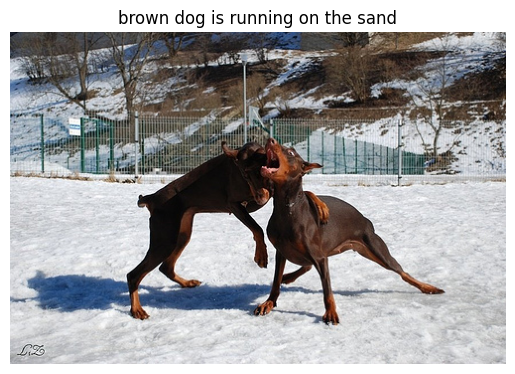

Image 2677656448_6b7e7702af: three girls lay on the end of the water


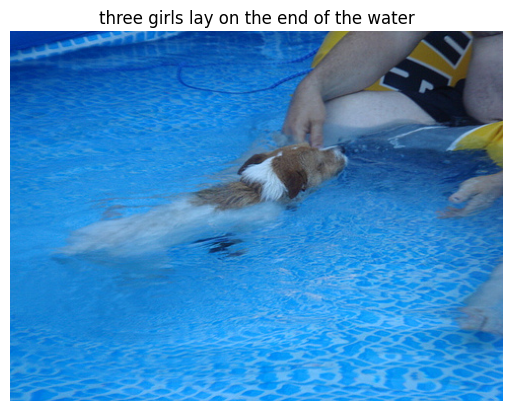

Image 311146855_0b65fdb169: man in bikini and shorts is walking along the street


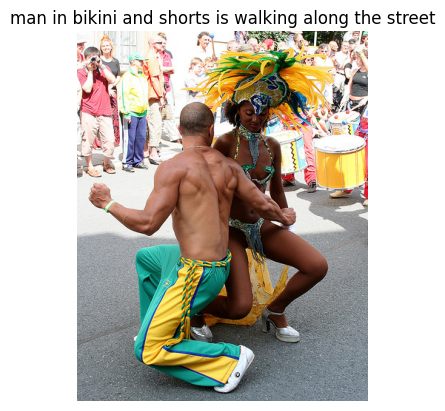

Image 1258913059_07c613f7ff: man sits on bench with dog in the background


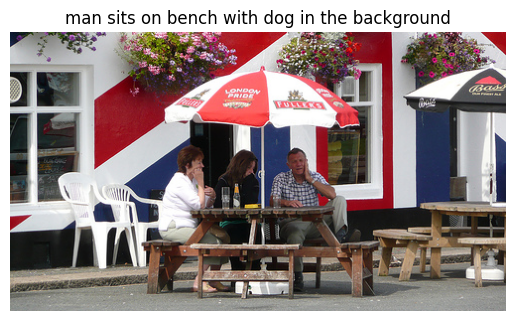

Image 241347760_d44c8d3a01: the football player in the red helmet is holding football


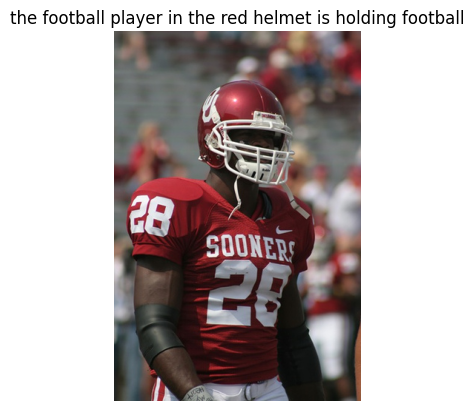

Image 2654514044_a70a6e2c21: dog running through the grass


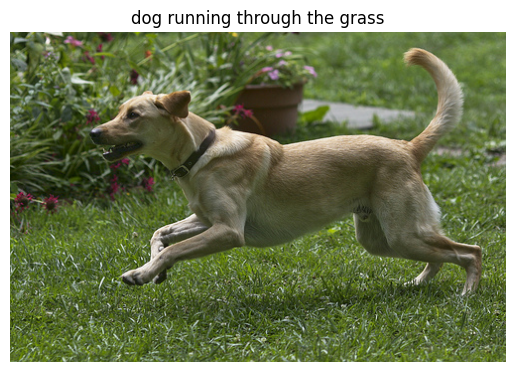

Image 2339106348_2df90aa6a9: woman in red sweater and sunglasses stands next to woman in red sweater


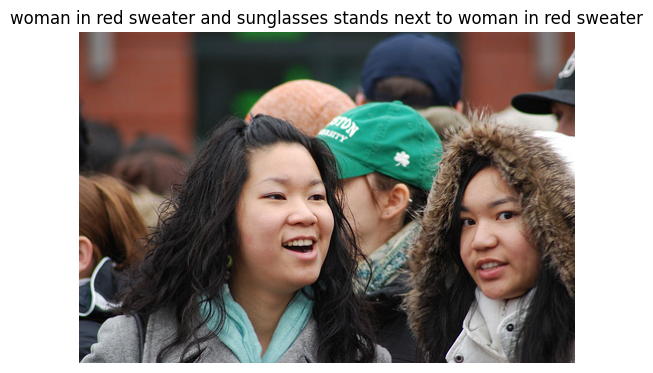

Image 256085101_2c2617c5d0: dog with black collar licking his nose


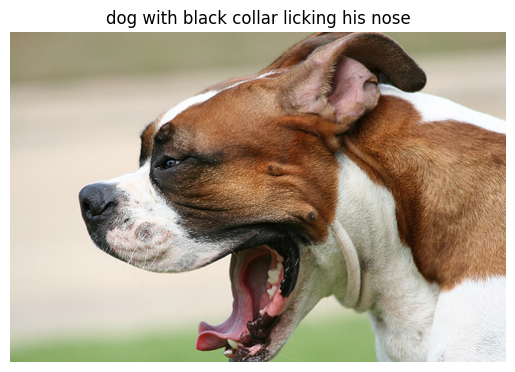

Image 280706862_14c30d734a: black dog is running through the water


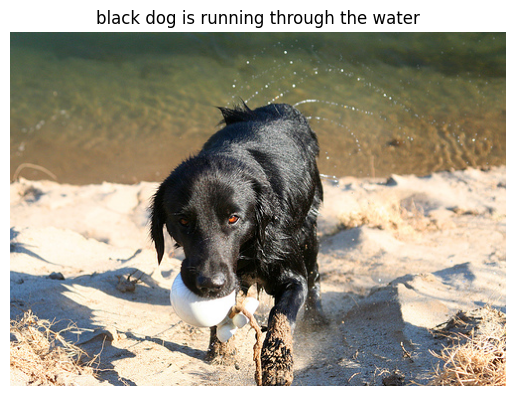

Image 3072172967_630e9c69d0: three men are playing basketball


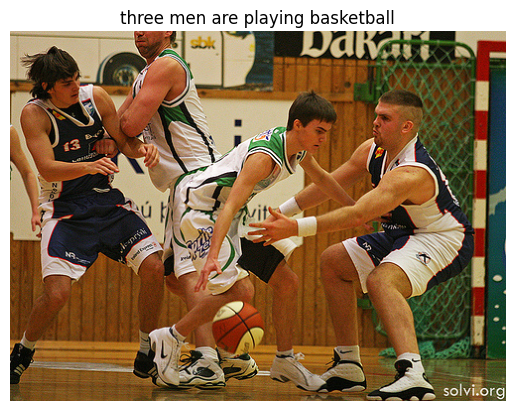

In [43]:
ix = 0
for image_id, caption in predicted_captions.items():
    if ix == 10:
        break
    ix+=1
    print(f"Image {image_id}: {caption}")
    show_image_with_caption(image_id, caption)

In [44]:
def greedySearch(photo):
    in_text = 'startseq'
    photo = photo.reshape(1, 2048)  # Ensure correct shape matching the Input layer
    
    for i in range(max_length):
        sequence = [wordtoindex[w] for w in in_text.split() if w in wordtoindex]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = lstm_base_model.predict([photo, sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = indextoword[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

Image 3385593926_d3e9c21170: brown the the the brown the the the the the the the the the the the the the the the the the the the the the the the the the the the the


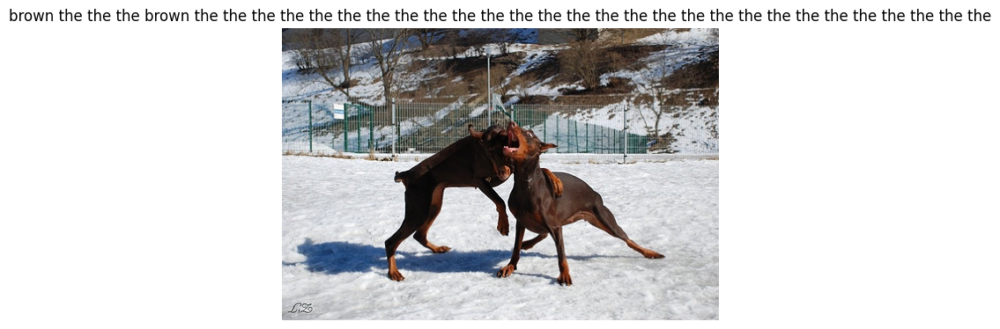

Image 2677656448_6b7e7702af: three three three three three three three three three three three three three three three three three three three three three three three three three three three three three three three three three


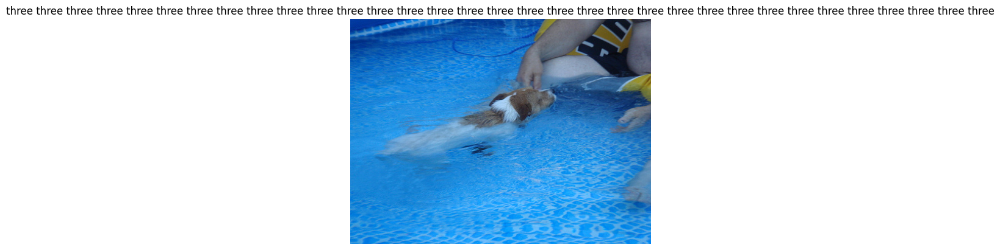

Image 311146855_0b65fdb169: man shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless shirtless


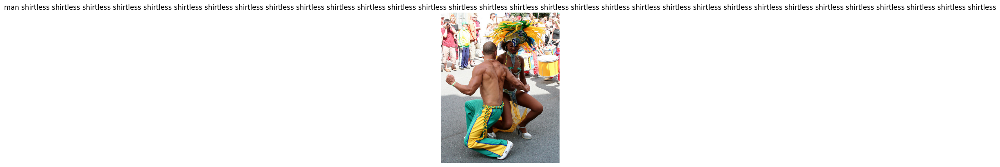

Image 1258913059_07c613f7ff: man man people couple at at sits at at sits sitting at at sits sitting at at sits sitting at at sits sitting at at sits sitting at at sits sitting at at


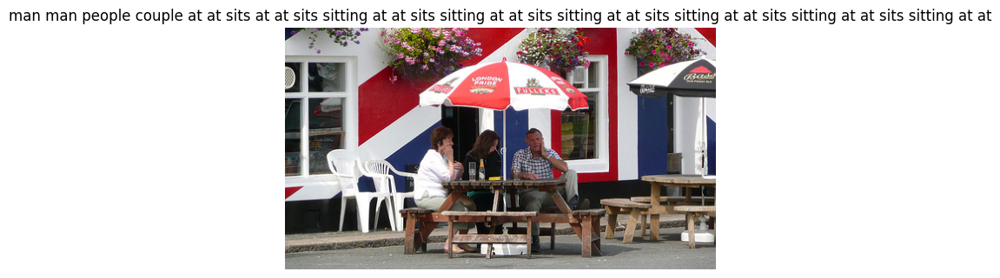

Image 241347760_d44c8d3a01: the the the the the football the the the football hugging the the the the the the the the football hugging the the the the the an the the the the the in


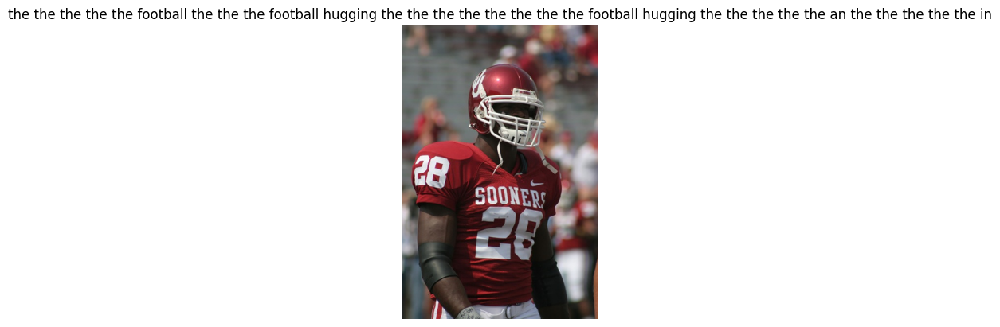

Image 2654514044_a70a6e2c21: dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog


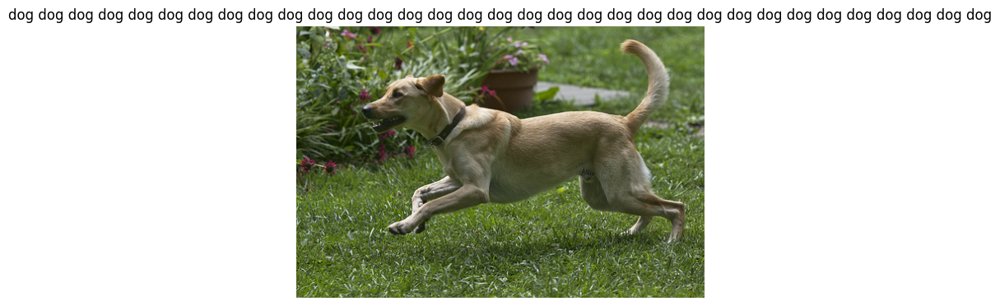

Image 2339106348_2df90aa6a9: woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman woman


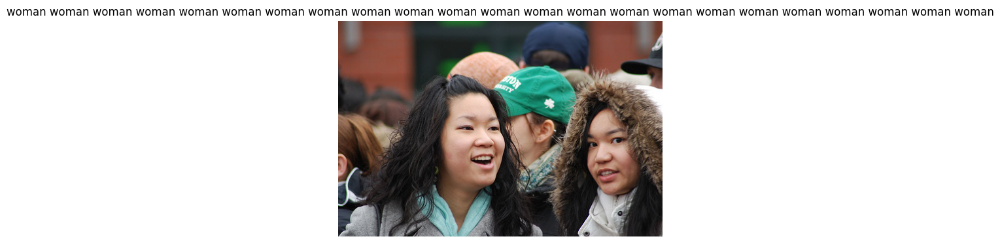

Image 256085101_2c2617c5d0: dog dog dog dog dog dog dog dog dog


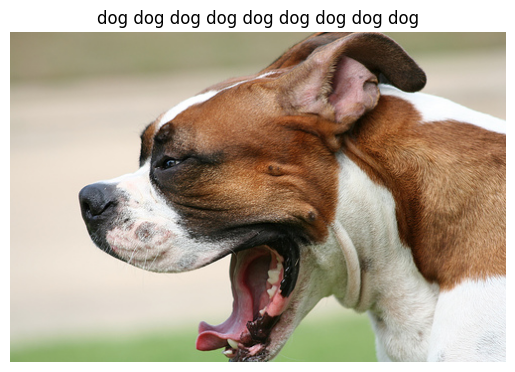

Image 280706862_14c30d734a: black black black black black black black black black black black black black black black black black black black black black black black black black black black black black black black black black


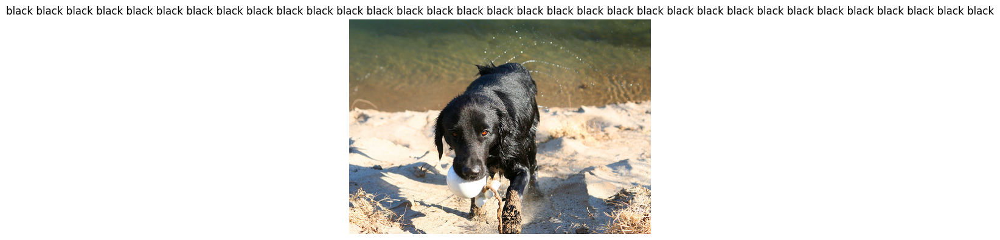

Image 3072172967_630e9c69d0: three three the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the


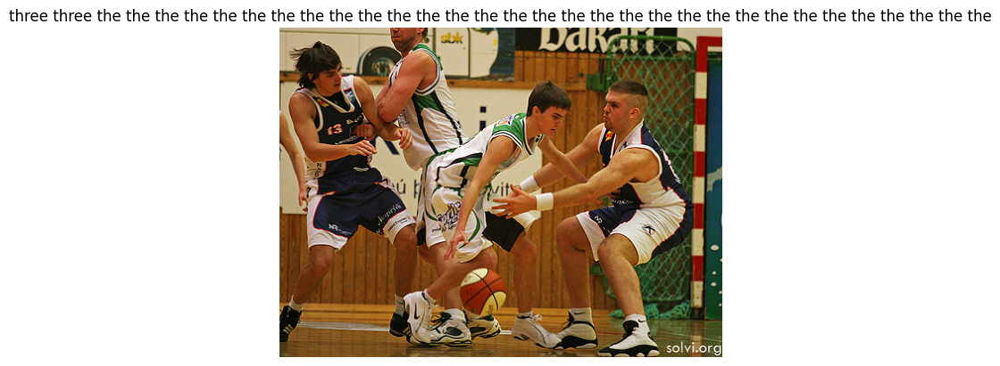

In [45]:
# Generate and display captions for the first 10 images
ix = 0
for image_id, photo in image_test_features.items():
    if ix == 10:
        break
    ix+=1
    caption = greedySearch(photo)
    print(f"Image {image_id}: {caption}")
    show_image_with_caption(image_id, caption)


In [46]:
from nltk.translate.bleu_score import corpus_bleu

def evaluate_model(predictions, actual_descriptions):
    actual, predicted = [], []
    for image_id in actual_descriptions.keys():
        refs = [d.split() for d in actual_descriptions[image_id]]
        pred = predictions[image_id].split()
        actual.append(refs)
        predicted.append(pred)
    print('BLEU-1: %f' % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
    print('BLEU-2: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
    print('BLEU-3: %f' % corpus_bleu(actual, predicted, weights=(0.3, 0.3, 0.3, 0)))
    print('BLEU-4: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))


In [47]:
actual_descriptions = {
    img_id: token_descriptions[img_id]
    for img_id in test if img_id in features
}

In [48]:
actual_descriptions

{'3385593926_d3e9c21170': ['the dogs are in the snow in front of fence',
  'the dogs play on the snow',
  'two brown dogs playfully fight in the snow',
  'two brown dogs wrestle in the snow',
  'two dogs playing in the snow'],
 '2677656448_6b7e7702af': ['brown and white dog swimming towards some in the pool',
  'dog in swimming pool swims toward sombody we cannot see',
  'dog swims in pool near person',
  'small dog is paddling through the water in pool',
  'the small brown and white dog is in the pool'],
 '311146855_0b65fdb169': ['man and woman in festive costumes dancing',
  'man and woman with feathers on her head dance',
  'man and woman wearing decorative costumes and dancing in crowd of onlookers',
  'one performer wearing feathered headdress dancing with another performer in the streets',
  'two people are dancing with drums on the right and crowd behind them'],
 '1258913059_07c613f7ff': ['couple of people sit outdoors at table with an umbrella and talk',
  'three people are sit

In [49]:
evaluate_model(predicted_captions, actual_descriptions)

BLEU-1: 0.459178
BLEU-2: 0.268736
BLEU-3: 0.188599
BLEU-4: 0.089790


In [50]:
for k in list(predicted_captions.keys())[:5]:
    print(f"Image: {k}")
    print("Predicted:", predicted_captions[k])
    print("Actual   :", actual_descriptions[k][0])
    print()

Image: 3385593926_d3e9c21170
Predicted: brown dog is running on the sand
Actual   : the dogs are in the snow in front of fence

Image: 2677656448_6b7e7702af
Predicted: three girls lay on the end of the water
Actual   : brown and white dog swimming towards some in the pool

Image: 311146855_0b65fdb169
Predicted: man in bikini and shorts is walking along the street
Actual   : man and woman in festive costumes dancing

Image: 1258913059_07c613f7ff
Predicted: man sits on bench with dog in the background
Actual   : couple of people sit outdoors at table with an umbrella and talk

Image: 241347760_d44c8d3a01
Predicted: the football player in the red helmet is holding football
Actual   : man is wearing sooners red football shirt and helmet



In [52]:
from tensorflow.keras.layers import GRU
def get_gru_model():
    inputs1 = Input(shape=(2048,))
    fe1 = Dropout(0.5)(inputs1)
    fe2 = Dense(256, activation='relu')(fe1)
    inputs2 = Input(shape=(max_length,))
    
    se1 = Embedding(vocab_size, embedding_dim, weights=[embedding_matrix], trainable=True)(inputs2)
    se2 = Dropout(0.5)(se1)
    se3 = GRU(256)(se2)
    
    decoder1 = add([fe2, se3])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax')(decoder2)
    
    # Load weights from the trained model
    model = Model(inputs=[inputs1, inputs2], outputs=outputs)
    return model

In [53]:
gru_base_model = get_gru_model()
gru_base_model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_3       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_1         │ (None, 34, 200)   │    390,000 │ input_layer_4[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 2048)      │          0 │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 34, 200)   │          0 │ embedding_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 256)       │    524,544 │ dropout_2[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru (GRU)           │ (None, 256)       │    351,744 │ dropout_3[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 256)       │          0 │ dense_3[0][0],    │
│                     │                   │            │ gru[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 256)       │     65,792 │ add_1[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_5 (Dense)     │ (None, 1950)      │    501,150 │ dense_4[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 1,833,230 (6.99 MB)

 Trainable params: 1,833,230 (6.99 MB)

 Non-trainable params: 0 (0.00 B)

In [55]:
gru_base_model.compile(loss="categorical_crossentropy", optimizer="sgd", metrics=['accuracy'])

In [57]:
gru_base_model_history = gru_base_model.fit(
    data_generated_using_generator,
    epochs=epochs,
    steps_per_epoch=steps,
    verbose=1
)

Epoch 1/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 48s 252ms/step - accuracy: 0.0751 - loss: 6.9923
Epoch 2/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 27s 147ms/step - accuracy: 0.1008 - loss: 5.7628
Epoch 3/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 32s 171ms/step - accuracy: 0.1011 - loss: 5.6031
Epoch 4/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 29s 156ms/step - accuracy: 0.1010 - loss: 5.5498
Epoch 5/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 30s 162ms/step - accuracy: 0.1013 - loss: 5.5183
Epoch 6/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 29s 153ms/step - accuracy: 0.1014 - loss: 5.4950
Epoch 7/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 26s 141ms/step - accuracy: 0.1013 - loss: 5.4802
Epoch 8/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 26s 135ms/step - accuracy: 0.1012 - loss: 5.4620
Epoch 9/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 28s 151ms/step - accuracy: 0.1013 - loss: 5.4506
Epoch 10/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 32s 171ms/step - accuracy: 0.1012 - loss: 5.4388
Epoch 11/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 28s 149ms/step - accuracy: 0.1006 - loss: 5.4260
Epoch 12/20
187/187

In [58]:
predicted_captions_gru = generate_predictions(gru_base_model, image_test_features, wordtoindex, indextoword, max_length)

Completed predicting 100 images in 31.58 seconds
Completed predicting 200 images in 28.87 seconds
Completed predicting 300 images in 26.56 seconds
Completed predicting 400 images in 32.07 seconds
Completed predicting 500 images in 29.24 seconds
Completed predicting 600 images in 21.99 seconds
Completed predicting 700 images in 31.23 seconds
Completed predicting 800 images in 14.61 seconds
Completed predicting 900 images in 38.71 seconds
Finished all predictions. Final block took 31.89 seconds.


In [59]:
def print_image_with_caption(caption_map):
    ix = 0
    for image_id, caption in caption_map.items():
        if ix == 10:
            break
        ix+=1
        print(f"Image {image_id}: {caption}")
        show_image_with_caption(image_id, caption)

Image 3385593926_d3e9c21170: 


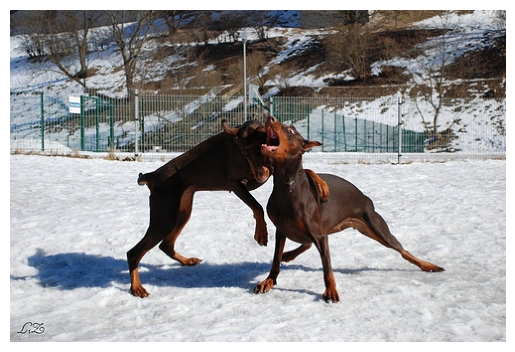

Image 2677656448_6b7e7702af: 


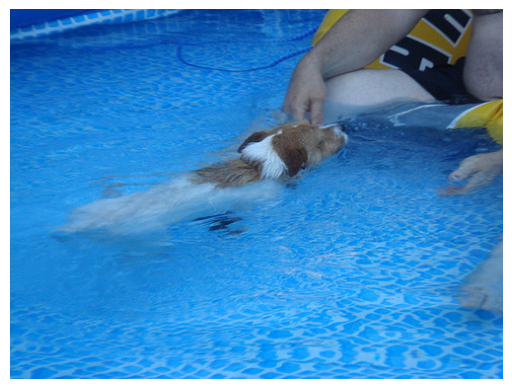

Image 311146855_0b65fdb169: 


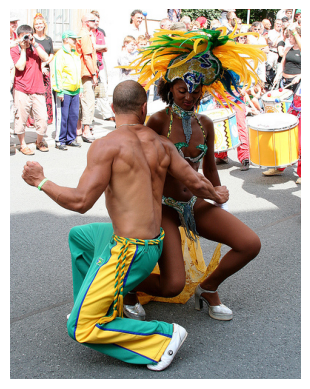

Image 1258913059_07c613f7ff: 


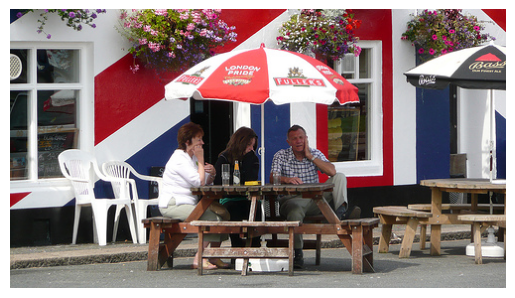

Image 241347760_d44c8d3a01: 


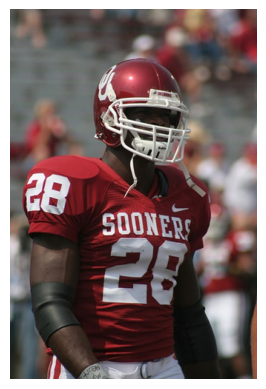

Image 2654514044_a70a6e2c21: dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog


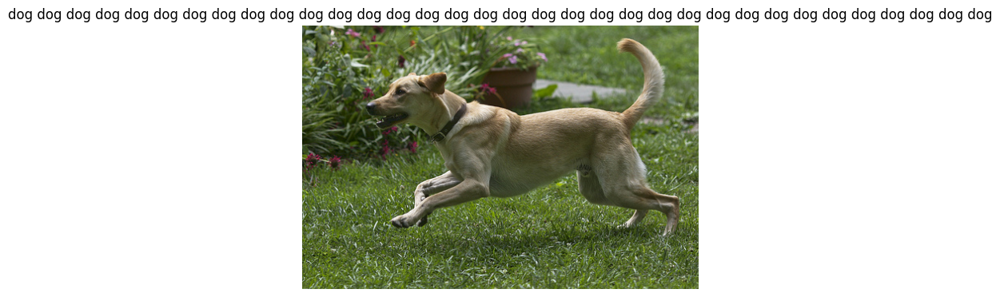

Image 2339106348_2df90aa6a9: 


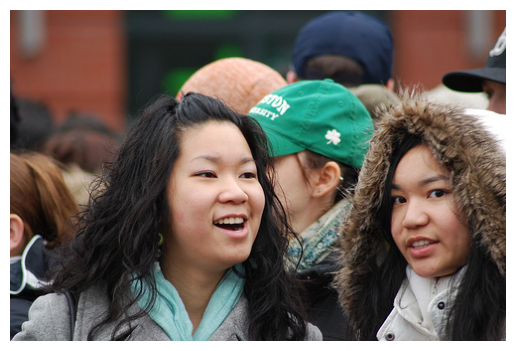

Image 256085101_2c2617c5d0: 


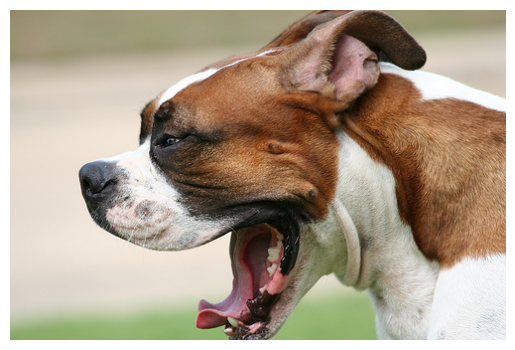

Image 280706862_14c30d734a: 


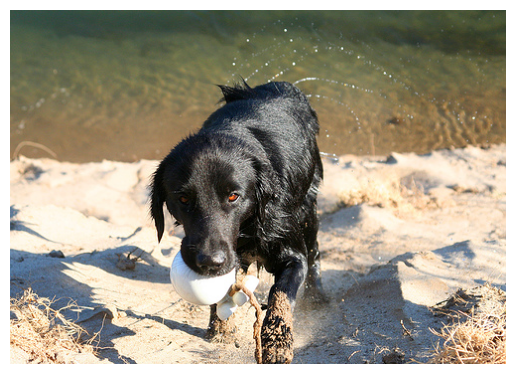

Image 3072172967_630e9c69d0: 


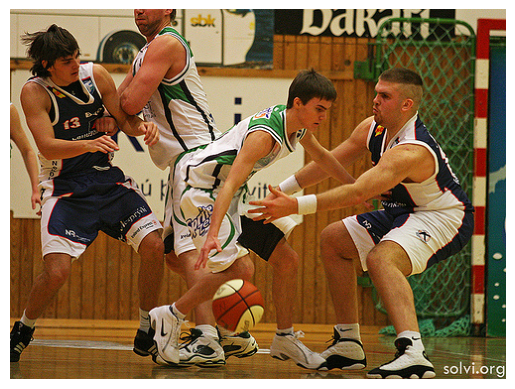

In [60]:
print_image_with_caption(predicted_captions_gru)

In [63]:
predicted_captions_gru

{'3385593926_d3e9c21170': '',
 '2677656448_6b7e7702af': '',
 '311146855_0b65fdb169': '',
 '1258913059_07c613f7ff': '',
 '241347760_d44c8d3a01': '',
 '2654514044_a70a6e2c21': 'dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog',
 '2339106348_2df90aa6a9': '',
 '256085101_2c2617c5d0': '',
 '280706862_14c30d734a': '',
 '3072172967_630e9c69d0': '',
 '3482062809_3b694322c4': '',
 '1167669558_87a8a467d6': '',
 '2847615962_c330bded6e': '',
 '3344233740_c010378da7': '',
 '2435685480_a79d42e564': '',
 '3110649716_c17e14670e': '',
 '2511019188_ca71775f2d': 'dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog',
 '2521770311_3086ca90de': '',
 '2723477522_d89f5ac62b': 'dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog dog',
 '2218609886_892dcd6915': '',

In [61]:
evaluate_model(predicted_captions_gru, actual_descriptions)

BLEU-1: 0.007531


/home/vikrant/.local/lib/python3.11/site-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/home/vikrant/.local/lib/python3.11/site-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/home/vikrant/.local/lib/python3.11/site-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use Smoothi

BLEU-2: 0.000000
BLEU-3: 0.000000
BLEU-4: 0.000000


In [62]:
def get_advanced_lstm_model():
    
    inputs1 = Input(shape=(2048,))
    fe1 = Dropout(0.5)(inputs1)
    fe2 = Dense(256, activation='relu')(fe1)
    
    # Caption input
    inputs2 = Input(shape=(max_length,))
    se1 = Embedding(vocab_size, embedding_dim, weights=[embedding_matrix], trainable=True)(inputs2)
    se2 = Dropout(0.5)(se1)
    
    # Stacked LSTMs
    se2 = LSTM(256, return_sequences=True)(se2)
    se2 = Dropout(0.5)(se2)
    se2 = LSTM(256, return_sequences=True)(se2)
    se2 = Dropout(0.5)(se2)
    se3 = LSTM(256)(se2)
    
    # Decoder
    decoder1 = add([fe2, se3])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax')(decoder2)
    
    # Define and return the model
    model = Model(inputs=[inputs1, inputs2], outputs=outputs)
    return model

In [64]:
lstm_stack_model = get_advanced_lstm_model()
lstm_stack_model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_2         │ (None, 34, 200)   │    390,000 │ input_layer_6[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_5 (Dropout) │ (None, 34, 200)   │          0 │ embedding_2[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_1 (LSTM)       │ (None, 34, 256)   │    467,968 │ dropout_5[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_6 (Dropout) │ (None, 34, 256)   │          0 │ lstm_1[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_5       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_2 (LSTM)       │ (None, 34, 256)   │    525,312 │ dropout_6[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_4 (Dropout) │ (None, 2048)      │          0 │ input_layer_5[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_7 (Dropout) │ (None, 34, 256)   │          0 │ lstm_2[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 256)       │    524,544 │ dropout_4[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_3 (LSTM)       │ (None, 256)       │    525,312 │ dropout_7[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_2 (Add)         │ (None, 256)       │          0 │ dense_6[0][0],    │
│                     │                   │            │ lstm_3[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_7 (Dense)     │ (None, 256)       │     65,792 │ add_2[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_8 (Dense)     │ (None, 1950)      │    501,150 │ dense_7[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 3,000,078 (11.44 MB)

 Trainable params: 3,000,078 (11.44 MB)

 Non-trainable params: 0 (0.00 B)

In [65]:
from tensorflow.keras.optimizers import Adam
lstm_stack_model.compile(loss="categorical_crossentropy", optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [66]:
lstm_stack_model_history = lstm_stack_model.fit(
    data_generated_using_generator,
    epochs=epochs,
    steps_per_epoch=steps,
    verbose=1
)

Epoch 1/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 28s 136ms/step - accuracy: 0.1229 - loss: 5.4480
Epoch 2/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 42ms/step - accuracy: 0.1898 - loss: 4.3932
Epoch 3/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 42ms/step - accuracy: 0.2468 - loss: 3.8587
Epoch 4/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 42ms/step - accuracy: 0.2745 - loss: 3.5662
Epoch 5/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.2913 - loss: 3.3911
Epoch 6/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.3045 - loss: 3.2636
Epoch 7/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.3131 - loss: 3.1649
Epoch 8/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 40ms/step - accuracy: 0.3217 - loss: 3.0846
Epoch 9/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.3285 - loss: 3.0138
Epoch 10/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.3346 - loss: 2.9550
Epoch 11/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 41ms/step - accuracy: 0.3403 - loss: 2.8977
Epoch 12/20
187/187 ━━━━━━━━━━━━━━━━━━━

In [67]:
predicted_captions_stack_lstm = generate_predictions(lstm_stack_model, image_test_features, wordtoindex, indextoword, max_length)

Completed predicting 100 images in 70.92 seconds
Completed predicting 200 images in 70.01 seconds
Completed predicting 300 images in 69.33 seconds
Completed predicting 400 images in 68.42 seconds
Completed predicting 500 images in 69.86 seconds
Completed predicting 600 images in 71.17 seconds
Completed predicting 700 images in 68.81 seconds
Completed predicting 800 images in 67.84 seconds
Completed predicting 900 images in 73.52 seconds
Finished all predictions. Final block took 64.91 seconds.


Image 3385593926_d3e9c21170: brown dog is digging on the sand


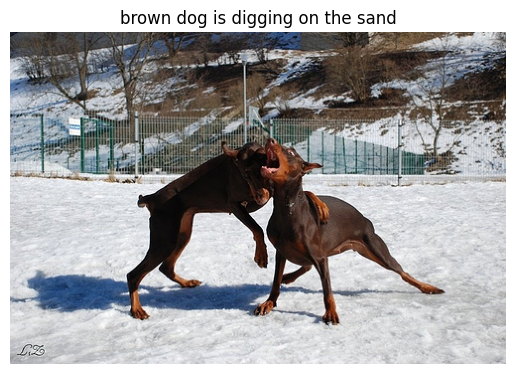

Image 2677656448_6b7e7702af: two girls are wrestling in pool


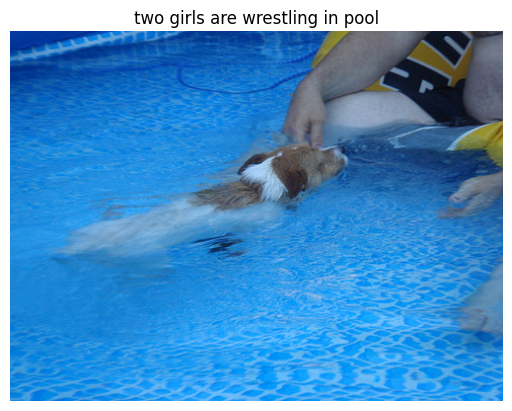

Image 311146855_0b65fdb169: man in red shirt is standing next to large red bottle


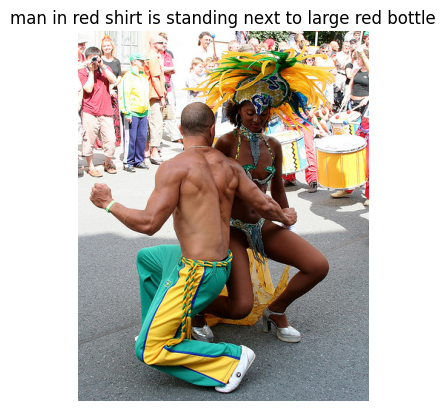

Image 1258913059_07c613f7ff: two people sit on bench with dog


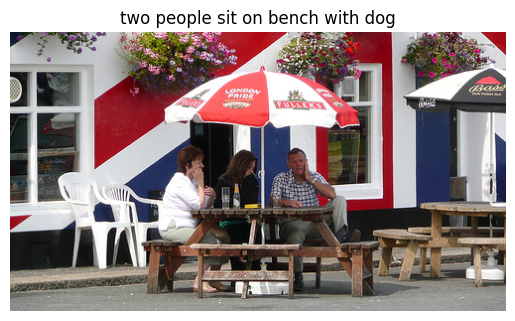

Image 241347760_d44c8d3a01: two football players are in the middle of the middle of the field


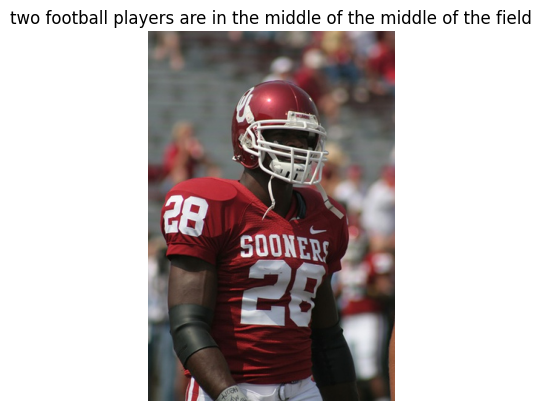

Image 2654514044_a70a6e2c21: brown dog is running through the grass


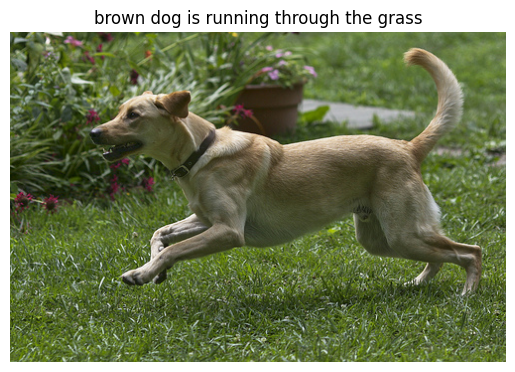

Image 2339106348_2df90aa6a9: two women in hats are smiling


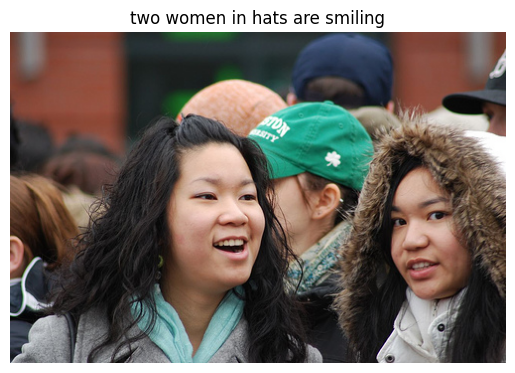

Image 256085101_2c2617c5d0: brown and white dog is licking its nose


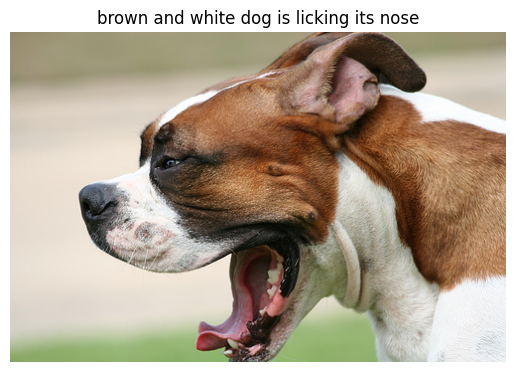

Image 280706862_14c30d734a: black dog is running through the water


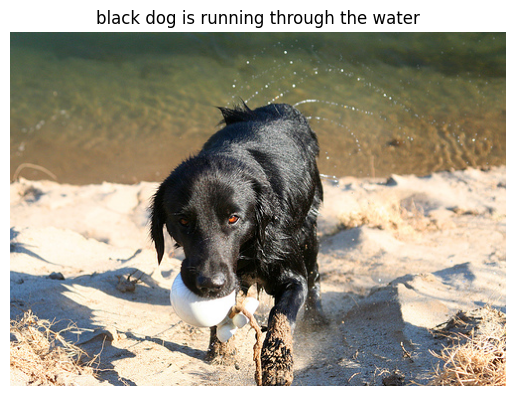

Image 3072172967_630e9c69d0: basketball player in white uniform is being by the ball


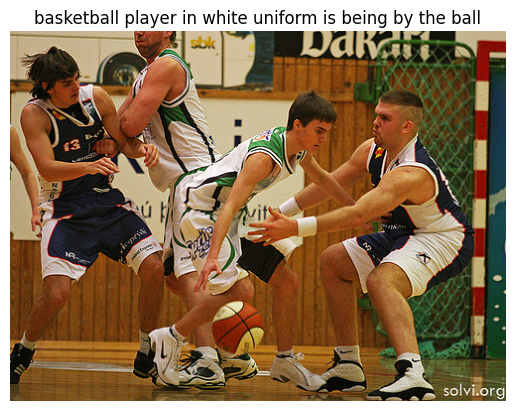

In [68]:
print_image_with_caption(predicted_captions_stack_lstm)

In [69]:
evaluate_model(predicted_captions_stack_lstm, actual_descriptions)

BLEU-1: 0.492602
BLEU-2: 0.305951
BLEU-3: 0.223007
BLEU-4: 0.115165


In [70]:
def get_advanced_gru_model():
    # Image feature input
    inputs1 = Input(shape=(2048,))
    fe1 = Dropout(0.5)(inputs1)
    fe2 = Dense(256, activation='relu')(fe1)

    # Caption input
    inputs2 = Input(shape=(max_length,))
    se1 = Embedding(vocab_size, embedding_dim, weights=[embedding_matrix], trainable=True)(inputs2)
    se2 = Dropout(0.5)(se1)

    # Stacked GRU layers
    se2 = GRU(256, return_sequences=True)(se2)
    se2 = Dropout(0.5)(se2)
    se2 = GRU(256, return_sequences=True)(se2)
    se2 = Dropout(0.5)(se2)
    se3 = GRU(256)(se2)

    # Decoder
    decoder1 = add([fe2, se3])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax')(decoder2)

    model = Model(inputs=[inputs1, inputs2], outputs=outputs)
    return model


In [71]:
gru_stacked_model = get_advanced_gru_model()
gru_stacked_model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8       │ (None, 34)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_3         │ (None, 34, 200)   │    390,000 │ input_layer_8[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_9 (Dropout) │ (None, 34, 200)   │          0 │ embedding_3[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_1 (GRU)         │ (None, 34, 256)   │    351,744 │ dropout_9[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_10          │ (None, 34, 256)   │          0 │ gru_1[0][0]       │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_7       │ (None, 2048)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_2 (GRU)         │ (None, 34, 256)   │    394,752 │ dropout_10[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_8 (Dropout) │ (None, 2048)      │          0 │ input_layer_7[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_11          │ (None, 34, 256)   │          0 │ gru_2[0][0]       │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_9 (Dense)     │ (None, 256)       │    524,544 │ dropout_8[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_3 (GRU)         │ (None, 256)       │    394,752 │ dropout_11[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_3 (Add)         │ (None, 256)       │          0 │ dense_9[0][0],    │
│                     │                   │            │ gru_3[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_10 (Dense)    │ (None, 256)       │     65,792 │ add_3[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_11 (Dense)    │ (None, 1950)      │    501,150 │ dense_10[0][0]    │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,622,734 (10.00 MB)

 Trainable params: 2,622,734 (10.00 MB)

 Non-trainable params: 0 (0.00 B)

In [75]:
from tensorflow.keras.optimizers import RMSprop
gru_stacked_model.compile(loss="categorical_crossentropy", optimizer=RMSprop(learning_rate=0.01), metrics=['accuracy'])

In [76]:
gru_stacked_model_history = gru_stacked_model.fit(
    data_generated_using_generator,
    epochs=epochs,
    steps_per_epoch=steps,
    verbose=1
)

Epoch 1/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 9s 40ms/step - accuracy: 0.0732 - loss: 7.3480
Epoch 2/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 39ms/step - accuracy: 0.1483 - loss: 4.9873
Epoch 3/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.1723 - loss: 4.6723
Epoch 4/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2177 - loss: 4.2621
Epoch 5/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2378 - loss: 4.0162
Epoch 6/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 40ms/step - accuracy: 0.2522 - loss: 3.8873
Epoch 7/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 8s 40ms/step - accuracy: 0.2596 - loss: 3.7959
Epoch 8/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2681 - loss: 3.7316
Epoch 9/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2737 - loss: 3.6601
Epoch 10/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2784 - loss: 3.6205
Epoch 11/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - accuracy: 0.2814 - loss: 3.5850
Epoch 12/20
187/187 ━━━━━━━━━━━━━━━━━━━━ 

In [77]:
predicted_captions_gru_stack = generate_predictions(gru_stacked_model, image_test_features, wordtoindex, indextoword, max_length)

Completed predicting 100 images in 79.80 seconds
Completed predicting 200 images in 78.23 seconds
Completed predicting 300 images in 71.74 seconds
Completed predicting 400 images in 75.92 seconds
Completed predicting 500 images in 83.62 seconds
Completed predicting 600 images in 74.57 seconds
Completed predicting 700 images in 76.35 seconds
Completed predicting 800 images in 83.86 seconds
Completed predicting 900 images in 73.28 seconds
Finished all predictions. Final block took 76.90 seconds.


Image 3385593926_d3e9c21170: two dogs are running through the grass


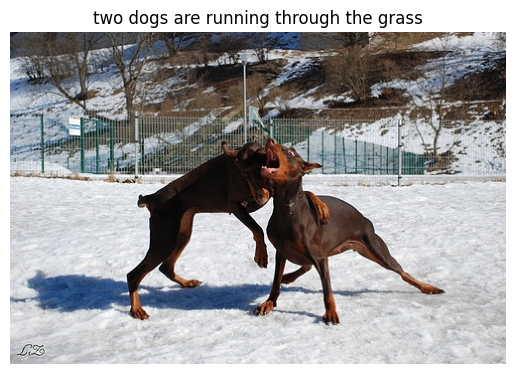

Image 2677656448_6b7e7702af: dog is running in the grass


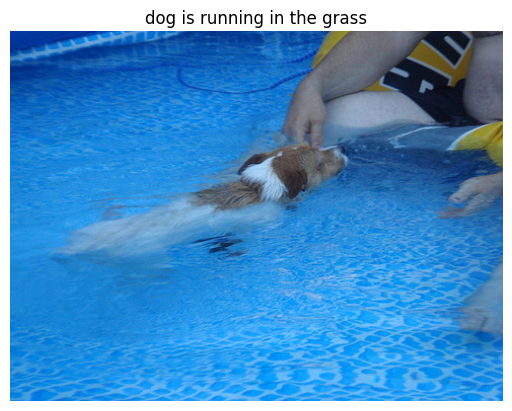

Image 311146855_0b65fdb169: two children are playing in the air


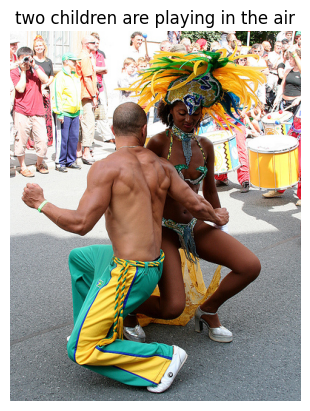

Image 1258913059_07c613f7ff: two children are sitting on sidewalk


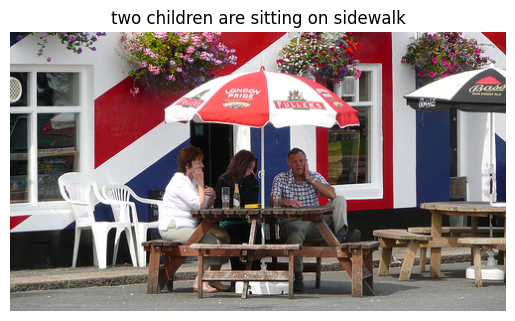

Image 241347760_d44c8d3a01: two soccer players are playing in the grass


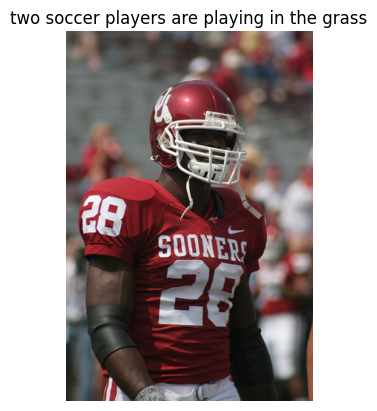

Image 2654514044_a70a6e2c21: two dogs are running through the grass


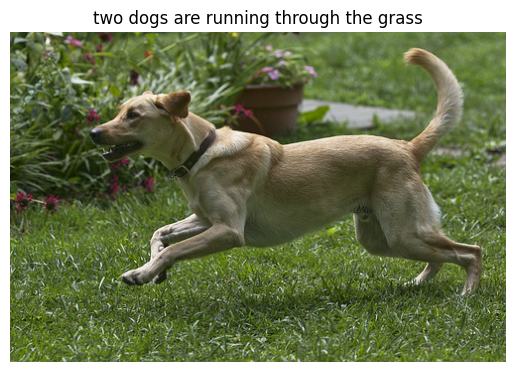

Image 2339106348_2df90aa6a9: woman in red shirt and black hat is standing in front of building


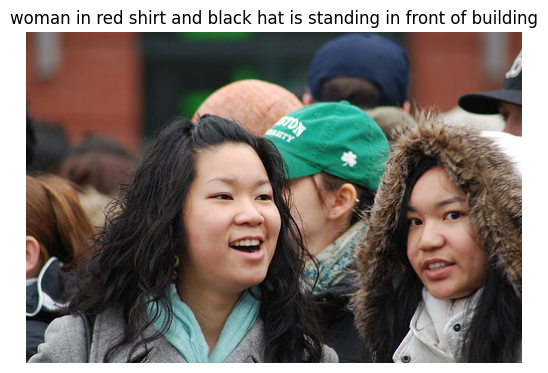

Image 256085101_2c2617c5d0: two dogs are running in the grass


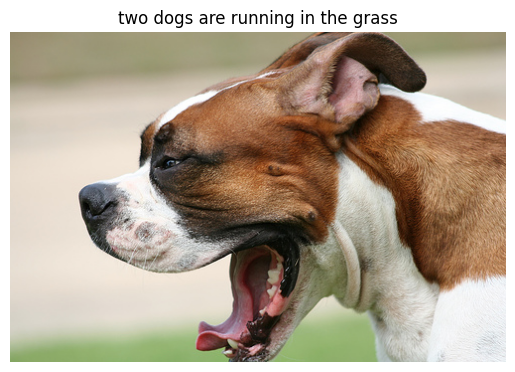

Image 280706862_14c30d734a: two dogs are running through the grass


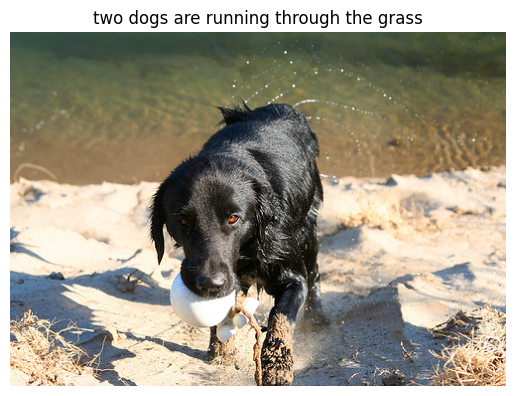

Image 3072172967_630e9c69d0: two men are playing basketball


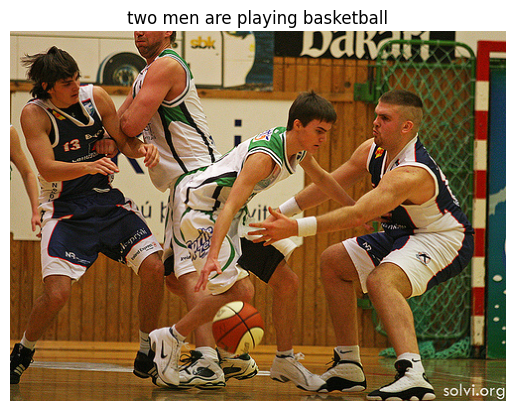

In [78]:
print_image_with_caption(predicted_captions_gru_stack)

In [79]:
evaluate_model(predicted_captions_gru_stack, actual_descriptions)

BLEU-1: 0.385073
BLEU-2: 0.209112
BLEU-3: 0.142176
BLEU-4: 0.060123


In [81]:
import matplotlib.pyplot as plt

def plot_history_graphs(history, title):
    plt.figure(figsize=(12, 5))
    plt.suptitle(title, fontsize=16, fontweight='bold')

    plt.subplot(1, 2, 1)
    plt.plot(history.history["accuracy"], label='Train Accuracy')
    plt.title("Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(history.history["loss"], label='Train Loss')
    plt.title("Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()


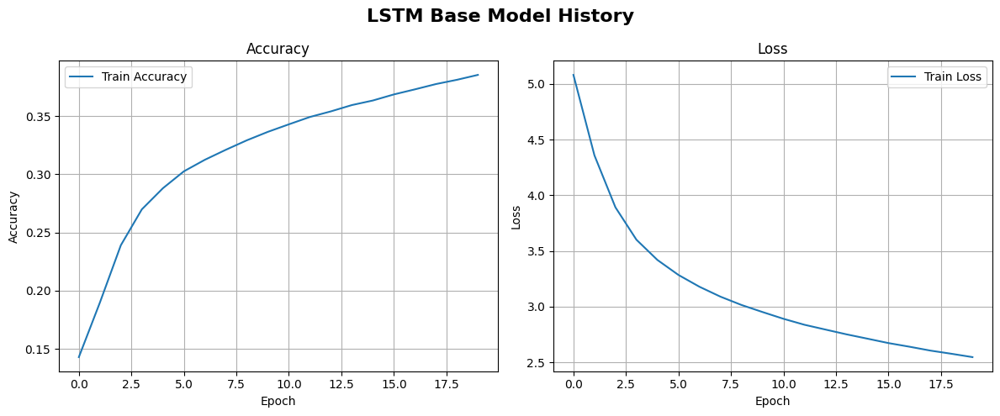

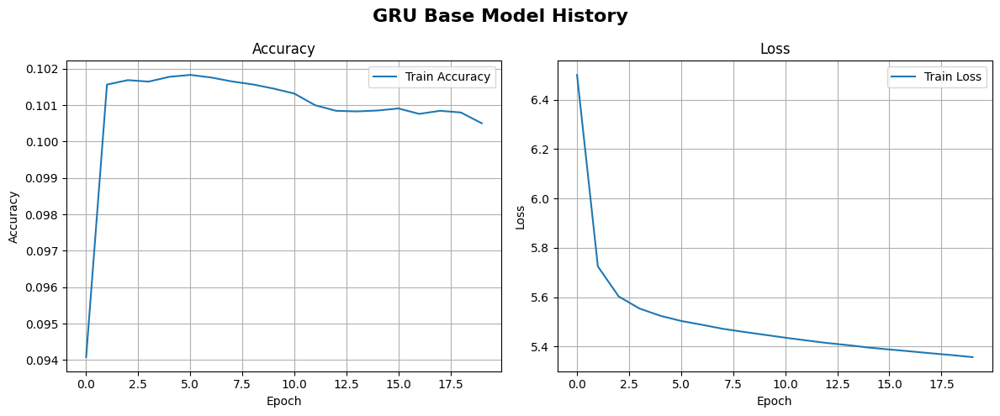

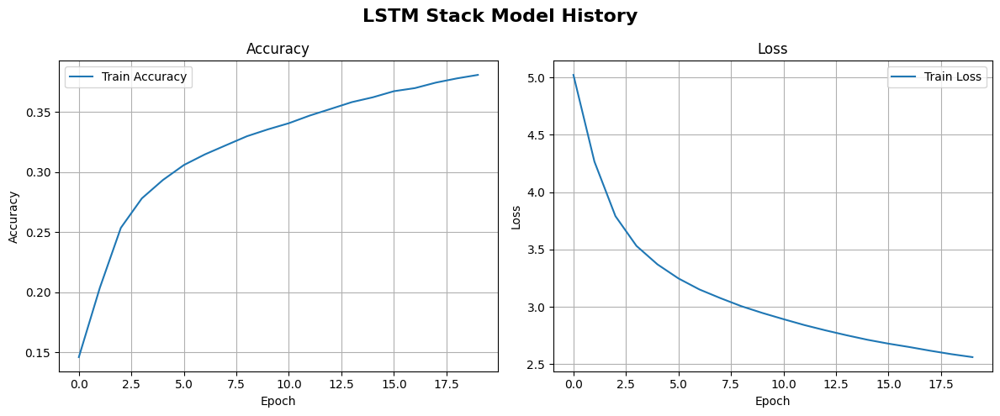

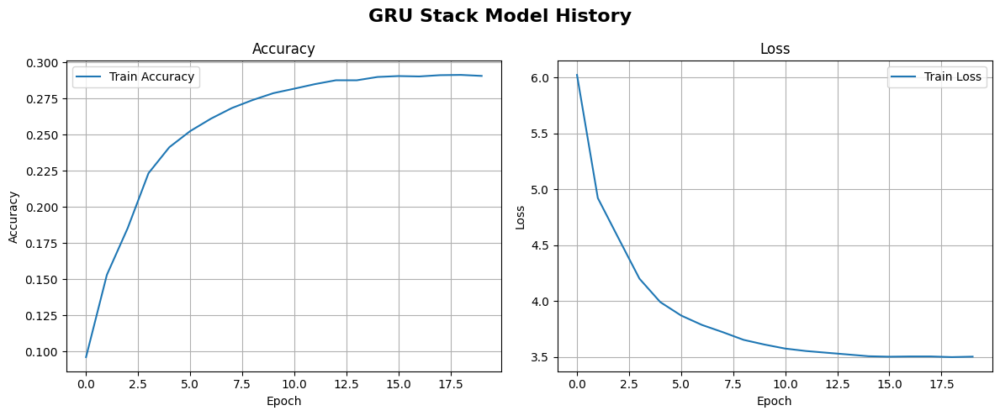

In [82]:
plot_history_graphs(lstm_base_model_history, "LSTM Base Model History")
plot_history_graphs(gru_base_model_history, "GRU Base Model History")
plot_history_graphs(lstm_stack_model_history, "LSTM Stack Model History")
plot_history_graphs(gru_stacked_model_history, "GRU Stack Model History")